# Laboratory practice 3.6: Regression VI

For this practice, you will need the following datasets:

- **fifa**: regression dataset containing FIFA players data:
    - short_name: name of the player
    - nationality
    - overall: overall score of the player (potential output)
    - potential: potential score of the player (potential output)
    - wage_eur: contract cancellation fine of the player (potential output)
    - value_eur: value in euros of the player (potential output)
    - age: age of the player in years
    - height_cm: height of the player in cm
    - weight_kg: weight of the player in kg
    - attacking_skills: several variables related to attacking
    - defending_skills: several variables related to defending
    - goalkeeping_skills: several variables related to goalkeeping

The main package for XAI in Python used here is DALEX. However, there are several more packages: SHAP, Lime, Shapash, ExplainerDashboard, Explainable Boosting Machines, ELI5, Alibi, Skater, EhticalML, Aix360, Diverse Counterfactual Explanations, ExplainX... 

Further reading:
- [DALEX](https://github.com/ModelOriented/DALEX)
- [SHAP](https://shap.readthedocs.io/en/latest/index.html)
- [Lime](https://github.com/marcotcr/lime)
- [Shapash](https://shapash.readthedocs.io/en/latest/)
- [ExplainerDashboard](https://medium.com/value-stream-design/making-ml-transparent-and-explainable-with-explainerdashboard-49953ae743dd)
- [Explainable Boosting Machines](https://towardsdatascience.com/interpretml-analysis-of-svm-and-xgboost-models-e68062f7299f)
- [ELI5](https://www.analyticsvidhya.com/blog/2020/11/demystifying-model-interpretation-using-eli5/)
- [Alibi](https://github.com/SeldonIO/alibi)
- [Skater](https://github.com/oracle/Skater)
- [EhticalML](https://github.com/EthicalML/xai)
- [Aix360](https://pypi.org/project/aix360/)
- [Diverse Counterfactual Explanations](https://github.com/interpretml/DiCE)
- [ExplainX](https://pypi.org/project/explainx/)

In addition, we will be using the following libraries:
- Data management
    - [numpy](https://numpy.org/)
    - [pandas](https://pandas.pydata.org/)

- Plotting
    - [seaborn](https://seaborn.pydata.org/)
    - [matplotlib](https://matplotlib.org/)

- Model analysis
    - MLTools
    - [scipy](https://scipy.org/)

In [123]:
### Load libraries ###

# interactive plotting
%matplotlib inline
%config InlineBackend.figure_format = 'svg' # ‘png’, ‘retina’, ‘jpeg’, ‘svg’, ‘pdf’

# plotting libraries
import seaborn as sns
import matplotlib.pyplot as plt
sns.set()


# Data management libraries
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Machine learning libraries
import math
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from lightgbm import LGBMRegressor

# XAI libraries
import dalex as dx
from lime.lime_tabular import LimeTabularExplainer 

# Other libraries
from mltools import model_tools as MT
from mltools import classification_tools as CT
from neuralsens import partial_derivatives as ns
from sklearn import set_config
set_config(display='diagram')
import warnings

warnings.filterwarnings("ignore")

In [124]:
### Load file --------------------------------------------
df = dx.datasets.load_fifa()
df.head()

,nationality,overall,potential,wage_eur,value_eur,age,height_cm,weight_kg,attacking_crossing,attacking_finishing,...,mentality_penalties,mentality_composure,defending_marking,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes
short_name,,,,,,,,,,,,,,,,,,,,,
L. Messi,Argentina,94,94,565000,95500000,32,170,72,88,95,...,75,96,33,37,26,6,11,15,14,8
Cristiano Ronaldo,Portugal,93,93,405000,58500000,34,187,83,84,94,...,85,95,28,32,24,7,11,15,14,11
Neymar Jr,Brazil,92,92,290000,105500000,27,175,68,87,87,...,90,94,27,26,29,9,9,15,15,11
J. Oblak,Slovenia,91,93,125000,77500000,26,188,87,13,11,...,11,68,27,12,18,87,92,78,90,89
E. Hazard,Belgium,91,91,470000,90000000,28,175,74,81,84,...,88,91,34,27,22,11,12,6,8,8


It will be useful for future exercises to include a position variable in the data frame, differentiating strikers and goalkeepers from the rest of positions.

In [160]:
goalkeeping = ['goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking', 'goalkeeping_positioning', 'goalkeeping_reflexes']
attacking= ['attacking_crossing', 'attacking_finishing', 'attacking_heading_accuracy', 'attacking_short_passing', 'attacking_volleys']
for i in range(len(df)):
    if df.iloc[i][attacking].mean()>70:
        df["position"][i]=2#Striker
    else:
        df["position"][i]=0#Other
    if df.iloc[i][goalkeeping].mean()>60:
        df["position"][i]=1#Goalkeeper

df["position"].astype("category")
df["position"].value_counts()


position
0.0    3895
2.0     638
1.0     467
Name: count, dtype: int64

In [161]:
X = df.drop(["nationality", "overall", "potential", "value_eur", "wage_eur"], axis = 1)
y = df['value_eur']

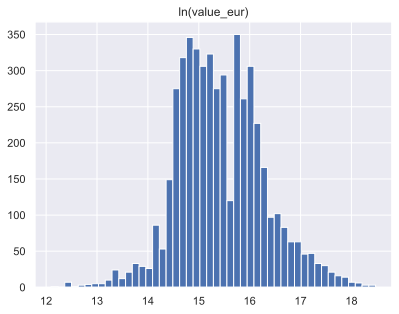

In [162]:
# Change scale of output variable
ylog = np.log(y)

plt.hist(ylog, bins='auto')
plt.title("ln(value_eur)")
plt.show()

In [194]:
X_train, X_test, ylog_train, ylog_test, y_train, y_test = train_test_split(X, ylog, y, test_size=0.25, random_state=4)

In [164]:
estimator = LGBMRegressor(n_jobs = -1)
param_test = {
    'n_estimators': list(range(201,1202,50)),
    'num_leaves': list(range(6, 42, 5)),
    'min_child_weight': [1e-3, 1e-2, 1e-1, 15e-2],
    'learning_rate': [1e-3, 1e-2, 1e-1, 15e-2]
}

gbm_fit = RandomizedSearchCV(
    estimator=estimator, 
    param_distributions=param_test, 
    n_iter=100,
    cv=4,
    random_state=1
)

gbm_fit.fit(X_train, ylog_train)
print('Best score reached: {} with params: {} '.format(gbm_fit.best_score_, gbm_fit.best_params_))

Best score reached: 0.9372999333846919 with params: {'num_leaves': 6, 'n_estimators': 951, 'min_child_weight': 0.1, 'learning_rate': 0.15} 


In [165]:
def predict_function(model, data):
    return np.exp(model.predict(data))
exp = dx.Explainer(gbm_fit, X_test, y_test, predict_function=predict_function)

Preparation of a new explainer is initiated

  -> data              : 1250 rows 38 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 1250 values
  -> model_class       : sklearn.model_selection._search.RandomizedSearchCV (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function predict_function at 0x0000026DACD6F600> will be used
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 3.53e+05, mean = 7.14e+06, max = 1.03e+08
  -> model type        : regression will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.5e+07, mean = 1.89e+05, max = 2.13e+07
  -> model_info        : package sklearn

A new explainer has been created!


---
### Ex 1. Obtain and plot global model performance measures

To obtain the global model performance we use the function exp.model_performance and specify that it is for a regression model

In [166]:
mp_gbm= exp.model_performance("regression")
mp_gbm

,mse,rmse,r2,mae,mad
RandomizedSearchCV,3.827334e+12,1.956357e+06,0.948702,1.070751e+06,583813.266212


In [167]:
y.describe()

count    5.000000e+03
mean     7.473287e+06
std      8.868077e+06
min      1.800000e+05
25%      2.700000e+06
50%      4.700000e+06
75%      8.500000e+06
max      1.055000e+08
Name: value_eur, dtype: float64

We need to understand the scale of values we are working with in order to extract conclusions from the following plot. It can be seen that the average of values is about 7.5 M, with a minimum of 1.8 M and a maximum of 105M.
Now, a graphic showing the distribution function of the absolute values of the residuals is shown, in order to understand the noise in our model. 

In [168]:
mp_gbm.plot()

As we can see in the plot, the absolute value of the residuals are mainly lowers than 5M in their response variable `value_eur`, indicating that the prediction is pretty accurate, as well as the value of $R^2$ in the previous table.

---
### Ex 2. Obtain and plot variable importance measures using the following variable groups

In [169]:
variable_groups = {
    'age': ['age'],
    'body': ['height_cm', 'weight_kg'],
    'attacking': ['attacking_crossing', 'attacking_finishing', 'attacking_heading_accuracy', 'attacking_short_passing', 'attacking_volleys'],
    'skill': ['skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control'],
    'movement': ['movement_acceleration', 'movement_sprint_speed', 'movement_agility', 'movement_reactions', 'movement_balance'],
    'power': ['power_shot_power', 'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots'],
    'mentality': ['mentality_aggression', 'mentality_interceptions', 'mentality_positioning', 'mentality_vision', 'mentality_penalties',
        'mentality_composure'],
    'defending': ['defending_marking', 'defending_standing_tackle','defending_sliding_tackle'],
    'goalkeeping' : ['goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking', 'goalkeeping_positioning', 'goalkeeping_reflexes']
}

In order to explain the importance of each group, a CV search is performed, in which the model predictions are obtained without using different groups each time, and it is studied how worse the model predictions are withou thos groups. The results obtained are shown below. 

In [170]:
vi_grouped = exp.model_parts(
                variable_groups = variable_groups,random_state=4)#A CV search is performed, so it is necessary to set a random_state in order to be able to replicate the results
vi_grouped.result

,variable,dropout_loss,label
0,_full_model_,1.934041e+06,RandomizedSearchCV
1,body,1.957644e+06,RandomizedSearchCV
2,power,2.932803e+06,RandomizedSearchCV
3,goalkeeping,3.530331e+06,RandomizedSearchCV
4,defending,3.849401e+06,RandomizedSearchCV
5,mentality,3.868931e+06,RandomizedSearchCV
6,age,3.979789e+06,RandomizedSearchCV
7,skill,4.514101e+06,RandomizedSearchCV
8,attacking,4.698054e+06,RandomizedSearchCV
9,movement,4.914305e+06,RandomizedSearchCV


In [171]:
vi_grouped.plot()

As we can see in the plot, along with the table, the most important group of varibles is `movement`, followed by `attacking` and `skill`. Besides, the group of variable `body` has nearly no importance in the model.

---
### Ex 3. Obtain which is the variable with higher influence in Leo Messi's value. Justify which algorithm you choose

To obtain which variable is the most important for Leo Messi, first we save all the information of the index 'L.Messi' in a variable named 'messi' 

In [172]:
messi = X_train.loc['L. Messi']
messi

age                            32.0
height_cm                     170.0
weight_kg                      72.0
attacking_crossing             88.0
attacking_finishing            95.0
attacking_heading_accuracy     70.0
attacking_short_passing        92.0
attacking_volleys              88.0
skill_dribbling                97.0
skill_curve                    93.0
skill_fk_accuracy              94.0
skill_long_passing             92.0
skill_ball_control             96.0
movement_acceleration          91.0
movement_sprint_speed          84.0
movement_agility               93.0
movement_reactions             95.0
movement_balance               95.0
power_shot_power               86.0
power_jumping                  68.0
power_stamina                  75.0
power_strength                 68.0
power_long_shots               94.0
mentality_aggression           48.0
mentality_interceptions        40.0
mentality_positioning          94.0
mentality_vision               94.0
mentality_penalties         

Next we apply the SHAP method for the new variable 'messi'. The algorithm provides insights into the contribution of variables to a particular prediction. Then we plot it to see the results obtained by the method.

In [176]:
sh_messi = exp.predict_parts(messi, type='shap', label="messi",random_state=4)
sh_messi.plot()

As we can see in the plot the most important value for Leo Messi is `movement_reactions` followed by `skill_ball_control` and `age`, the last one in a negative way, what makes sense considering that 32 years old is near the end of the career of a footballer, so a player with 32 years old will always be less valuable than one with 22.

Break-down (BD) plots and Shapley values are most suitable for models with a small or moderate number of explanatory variables. None of those approaches is well-suited for models with a very large number of explanatory variables, because they usually determine non-zero attributions for all variables in the model. In such cases, sparse explanations with a small number of variables offer a useful alternative.

For that reason LIME is also used, as it is desired to quantify the importance of explanatory variables in the context of a single-instance prediction. In this case, a linear regression is used as the glass-box model.

In [138]:
model = gbm_fit.best_estimator_
X_lime = X.values
f_names = X.columns.tolist() 

explainer = LimeTabularExplainer(X_lime, 
                    feature_names=f_names,  
                    mode='regression', 
                    verbose=True)

lime = explainer.explain_instance(messi.values, model.predict)
lime.show_in_notebook(show_table=True)

Intercept 14.903111383201718
Prediction_local [16.04638277]
Right: 18.353727513083456


As it is seen, the results are pretty similar, being the most influyent predictors `age`, `movement_reactions` and `skill_ball_control`, also the first one down-pricing the player (Due to the previous reasons, it seems as a better option to use LIME instead of SHAP, but in the last exercise it will also be used LIME. Therefore, we thought it would be nice to use both methods and compare the results).

---
### Ex 4. Explain how perturbating the `height_cm` variable affect the value of Cristiano Ronaldo

In [177]:
ronaldo = X_train.loc['Cristiano Ronaldo']
ronaldo

age                            34.0
height_cm                     187.0
weight_kg                      83.0
attacking_crossing             84.0
attacking_finishing            94.0
attacking_heading_accuracy     89.0
attacking_short_passing        83.0
attacking_volleys              87.0
skill_dribbling                89.0
skill_curve                    81.0
skill_fk_accuracy              76.0
skill_long_passing             77.0
skill_ball_control             92.0
movement_acceleration          89.0
movement_sprint_speed          91.0
movement_agility               87.0
movement_reactions             96.0
movement_balance               71.0
power_shot_power               95.0
power_jumping                  95.0
power_stamina                  85.0
power_strength                 78.0
power_long_shots               93.0
mentality_aggression           63.0
mentality_interceptions        29.0
mentality_positioning          95.0
mentality_vision               82.0
mentality_penalties         

In [178]:
cp_ronaldo = exp.predict_profile(ronaldo)
cp_ronaldo.result

Calculating ceteris paribus:   0%|          | 0/38 [00:00<?, ?it/s]

Calculating ceteris paribus: 100%|██████████| 38/38 [00:00<00:00, 131.91it/s]


,age,height_cm,weight_kg,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,...,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,position,_original_,_yhat_,_vname_,_ids_,_label_
Cristiano Ronaldo,17.00,187.0,83.0,84.0,94.0,89.0,83.0,87.0,89.0,81.0,...,11.0,15.0,14.0,11.0,2.00,34.0,1.230435e+08,age,Cristiano Ronaldo,RandomizedSearchCV
Cristiano Ronaldo,17.23,187.0,83.0,84.0,94.0,89.0,83.0,87.0,89.0,81.0,...,11.0,15.0,14.0,11.0,2.00,34.0,1.230435e+08,age,Cristiano Ronaldo,RandomizedSearchCV
Cristiano Ronaldo,17.46,187.0,83.0,84.0,94.0,89.0,83.0,87.0,89.0,81.0,...,11.0,15.0,14.0,11.0,2.00,34.0,1.230435e+08,age,Cristiano Ronaldo,RandomizedSearchCV
Cristiano Ronaldo,17.69,187.0,83.0,84.0,94.0,89.0,83.0,87.0,89.0,81.0,...,11.0,15.0,14.0,11.0,2.00,34.0,1.230435e+08,age,Cristiano Ronaldo,RandomizedSearchCV
Cristiano Ronaldo,17.92,187.0,83.0,84.0,94.0,89.0,83.0,87.0,89.0,81.0,...,11.0,15.0,14.0,11.0,2.00,34.0,1.230435e+08,age,Cristiano Ronaldo,RandomizedSearchCV
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Cristiano Ronaldo,34.00,187.0,83.0,84.0,94.0,89.0,83.0,87.0,89.0,81.0,...,11.0,15.0,14.0,11.0,1.92,2.0,5.959552e+07,position,Cristiano Ronaldo,RandomizedSearchCV
Cristiano Ronaldo,34.00,187.0,83.0,84.0,94.0,89.0,83.0,87.0,89.0,81.0,...,11.0,15.0,14.0,11.0,1.94,2.0,5.959552e+07,position,Cristiano Ronaldo,RandomizedSearchCV
Cristiano Ronaldo,34.00,187.0,83.0,84.0,94.0,89.0,83.0,87.0,89.0,81.0,...,11.0,15.0,14.0,11.0,1.96,2.0,5.959552e+07,position,Cristiano Ronaldo,RandomizedSearchCV
Cristiano Ronaldo,34.00,187.0,83.0,84.0,94.0,89.0,83.0,87.0,89.0,81.0,...,11.0,15.0,14.0,11.0,1.98,2.0,5.959552e+07,position,Cristiano Ronaldo,RandomizedSearchCV


In [179]:
cp_ronaldo.plot(variables='height_cm')

As it is observed in the plot, the `height_cm` is an important (but not determinant) variable for the value of Cristiano Ronaldo. Having a lower height could lead to a more than 2M loss in his price, and if he would be 3cm higher, his value could risen up to more than 60M.

---
### Ex 5. Explain the average effect of the `age` variable on the model predictions. Does it differ greatly along the samples in the dataset? Which should be more affected by perturbating this variable, the goalkeepers or the strikers?

In this case it will be used a PDP. The general idea underlying the construction of PD profiles is to show how does the expected value of model prediction behave as a function of a selected explanatory variable (Specifically, the `age` variable). For a single model, one can construct an overall PDP by using all observations from a dataset, or several profiles for sub-groups of the observations.


In [180]:
# Define the list of variables you want to include in the model profile
INPUTS = X.columns.tolist()

In [181]:
pd_gbm = exp.model_profile(variables = ["age"])
pd_gbm.result

Calculating ceteris paribus: 100%|██████████| 1/1 [00:00<00:00,  3.56it/s]


,_vname_,_label_,_x_,_yhat_,_ids_
0,age,RandomizedSearchCV,17.00,1.132667e+07,0
1,age,RandomizedSearchCV,17.23,1.132667e+07,0
2,age,RandomizedSearchCV,17.46,1.132667e+07,0
3,age,RandomizedSearchCV,17.69,1.132667e+07,0
4,age,RandomizedSearchCV,17.92,1.132667e+07,0
...,...,...,...,...,...
96,age,RandomizedSearchCV,39.08,1.907848e+06,0
97,age,RandomizedSearchCV,39.31,1.907848e+06,0
98,age,RandomizedSearchCV,39.54,1.907848e+06,0
99,age,RandomizedSearchCV,39.77,1.907848e+06,0


In [182]:
pd_gbm.plot(geom = 'profiles')


From the previous plot, 2 main conclussions can be made. To start, the plot shows(blue line) how the average effect of the age in the players value is clearly a decreasing effect. Besides that, it can also be seen that this effect is shared by pretty much all the observations the plot shows, as if the grey lines are checked, all these lines decrease as the age increases (obviously, the players whose value is higher, the loss of price is also greater).

About the question of which players value, strikers or goalkeepers, should be more affected by the age, the obvious answer seems to be the strikers, as goalkeepers tend to have longer careers. However, PDPs can help us answer this question.
In order to do that, it is needed to classify if the players are strikers, goalkeepers or play in other position. To determine this, variables of attacking and goalkeeping are checked, setting a threshold so if a player has good finishing stats, it is considered as a striker, and if has good goalkeeping skills, it will be considered a goalkeeper.

In [183]:


pd_mlp = exp.model_profile(groups = 'position', variables = ['age'])
pd_mlp.plot()


Calculating ceteris paribus: 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]


As a remainder, the blue line represents strikers, the red line represents goalkeepers, and the green one represents other positions. In general, it can be seen how the strikers are the most valuable players in the dataset. However, it is also true that the decrease in value for the strikers as their age grow is much sharper than for goalkeepers or other positions, just as we mentioned before that could be expected.

---
### Ex 6. Explain the prediction made for Hazard using a local surrogate model (Lime)

In order to extract the observation that corresponds to Eden Hazard, the variable position is dropped from the data frame.

In [201]:
X.drop("position",axis=1)
X_train, X_test  = train_test_split(X, test_size=0.25, random_state=4)


In [202]:
hazard = X_test.loc['E. Hazard']
print(hazard)
print("Hazard market value is:");print(y_test.loc['E. Hazard'])

age                            28
height_cm                     175
weight_kg                      74
attacking_crossing             81
attacking_finishing            84
attacking_heading_accuracy     61
attacking_short_passing        89
attacking_volleys              83
skill_dribbling                95
skill_curve                    83
skill_fk_accuracy              79
skill_long_passing             83
skill_ball_control             94
movement_acceleration          94
movement_sprint_speed          88
movement_agility               95
movement_reactions             90
movement_balance               94
power_shot_power               82
power_jumping                  56
power_stamina                  84
power_strength                 63
power_long_shots               80
mentality_aggression           54
mentality_interceptions        41
mentality_positioning          87
mentality_vision               89
mentality_penalties            88
mentality_composure            91
defending_mark

Hazard has a market value of 90M, so he is one of the most valuable players in the data set, and by looking at his stats, his attacking and movement skills stand out. 
A regression model is adjusted locally, in order to understand more deeply, which are the variables that explain Hazard´s high value. Only the 15 most important variables to predict Hazard´s value will be shown. 

In [205]:
#X=X.drop("position",axis=1)
print(X.columns)
f_names = X.columns.tolist()

X_lime = X.values

explainer = LimeTabularExplainer(X_lime, 
                    feature_names=f_names, 
                    mode='regression', 
                    verbose=True)

lime = explainer.explain_instance(hazard.values, model.predict,num_features=15,top_labels=15)
lime.show_in_notebook(show_table=True)

Index(['age', 'height_cm', 'weight_kg', 'attacking_crossing',
       'attacking_finishing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys', 'skill_dribbling',
       'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
       'skill_ball_control', 'movement_acceleration', 'movement_sprint_speed',
       'movement_agility', 'movement_reactions', 'movement_balance',
       'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots', 'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defending_marking', 'defending_standing_tackle',
       'defending_sliding_tackle', 'goalkeeping_diving',
       'goalkeeping_handling', 'goalkeeping_kicking',
       'goalkeeping_positioning', 'goalkeeping_reflexes'],
      dtype='object')
Intercept 14.79225014293816
Prediction_local [16.58829092]
Right: 18.202031912817475


Obviously, as Hazard´s value is so high, almost everyone of the 15 most important variables contribute positively to his value. Analyzing these 15 variables deeply, it feels like the attacking, movement and skills variables are the ones in which Hazard excels and increase his value. On the other hand, variables relationed with phisicality, such as the strength or his headers ability are the ones that make his value decrease slightly. It makes sense as Hazard is a small yet very skilled offensive player.

# End Of Laboratory practice 3.6
---